In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = "0"

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from datasets import load_dataset
from clustering import ClusterClassifier
import gc
import torch
from datasets import load_dataset
from cycler import cycler
import matplotlib.pyplot as plt
from cycler import cycler
from dotenv import load_dotenv


import pandas as pd
import numpy as np
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
from kneed import KneeLocator
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
from tqdm import tqdm
from scipy.stats import entropy

/home/infres/abounhar/.local/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Helper functions

In [3]:
def find_optimal_eps(embeddings, min_samples=5, n_jobs=-1):
    """
    Find optimal eps parameter for DBSCAN using k-distance graph
    
    Args:
        embeddings: array of shape (n_samples, n_features)
        min_samples: int, minimum samples parameter for DBSCAN
        n_jobs: int, number of parallel jobs to run
    
    Returns:
        float: optimal eps value
    """
    # Calculate distances to k nearest neighbors
    neigh = NearestNeighbors(n_neighbors=min_samples, n_jobs=n_jobs)
    neigh.fit(embeddings)
    distances, _ = neigh.kneighbors(embeddings)
    
    # Sort distances to the kth neighbor
    k_distances = np.sort(distances[:, -1])
    
    # Plot k-distance graph
    plt.figure(figsize=(12, 6))
    
    # Plot k-distance curve
    x_axis = np.arange(len(k_distances))
    plt.plot(x_axis, k_distances, 'b-', label='k-distance curve')
    
    # Find elbow point using kneed package
    kneedle = KneeLocator(
        x_axis, 
        k_distances,
        S=1.0,
        curve='convex',
        direction='increasing',
        online=True
    )
    optimal_eps = k_distances[kneedle.elbow]
    
    # Plot optimal eps
    plt.axhline(y=optimal_eps, color='r', linestyle='--', 
                label=f'Optimal eps ≈ {optimal_eps:.3f}')
    plt.axvline(x=kneedle.elbow, color='g', linestyle='--', 
                label=f'Elbow point at x={kneedle.elbow}')
    
    plt.xlabel('Points sorted by distance')
    plt.ylabel(f'Distance to {min_samples}th nearest neighbor')
    plt.title('K-distance Graph for DBSCAN Eps Parameter')
    plt.legend()
    plt.grid(True)
    plt.show()
    
    return optimal_eps

def evaluate_dbscan_params(embeddings, eps_range=None, min_samples_range=None):
    """
    Evaluate different DBSCAN parameters
    
    Args:
        embeddings: array of shape (n_samples, n_features)
        eps_range: array-like of eps values to try
        min_samples_range: array-like of min_samples values to try
    """
    if eps_range is None:
        optimal_eps = find_optimal_eps(embeddings)
        eps_range = np.linspace(optimal_eps * 0.5, optimal_eps * 1.5, 10)
    
    if min_samples_range is None:
        # Rule of thumb: 2 * dimensions + 1
        min_samples_range = [5, 10, 15, 20, 25]
    
    results = []
    
    for eps in tqdm(eps_range):
        for min_samples in min_samples_range:
            dbscan = DBSCAN(eps=eps, min_samples=min_samples)
            labels = dbscan.fit_predict(embeddings)
            
            # Skip if all points are noise
            if len(np.unique(labels)) <= 1:
                continue
                
            # Calculate metrics
            n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
            noise_points = np.sum(labels == -1)
            noise_ratio = noise_points / len(labels)
            
            # Calculate silhouette score (excluding noise points)
            if n_clusters > 1:
                non_noise_mask = labels != -1
                silhouette = silhouette_score(
                    embeddings[non_noise_mask], 
                    labels[non_noise_mask]
                )
            else:
                silhouette = -1
                
            results.append({
                'eps': eps,
                'min_samples': min_samples,
                'n_clusters': n_clusters,
                'noise_ratio': noise_ratio,
                'silhouette_score': silhouette
            })
    
    results_df = pd.DataFrame(results)
    # print(f'results_df: {results_df}')
    
    # Visualize results
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))
    
    # Plot number of clusters
    for min_samples in min_samples_range:
        mask = results_df['min_samples'] == min_samples
        axes[0, 0].plot(
            results_df[mask]['eps'].values,  # Convert to numpy array
            results_df[mask]['n_clusters'].values,  # Convert to numpy array
            'o-', 
            label=f'min_samples={min_samples}'
        )
    axes[0, 0].set_xlabel('eps')
    axes[0, 0].set_ylabel('Number of clusters')
    axes[0, 0].set_title('Number of Clusters vs Parameters')
    axes[0, 0].legend()
    axes[0, 0].grid(True)

    # Plot noise ratio
    for min_samples in min_samples_range:
        mask = results_df['min_samples'] == min_samples
        axes[0, 1].plot(
            results_df[mask]['eps'].values,  # Convert to numpy array
            results_df[mask]['noise_ratio'].values,  # Convert to numpy array
            'o-', 
            label=f'min_samples={min_samples}'
        )
    axes[0, 1].set_xlabel('eps')
    axes[0, 1].set_ylabel('Noise ratio')
    axes[0, 1].set_title('Noise Ratio vs Parameters')
    axes[0, 1].legend()
    axes[0, 1].grid(True)

    # Plot silhouette score
    for min_samples in min_samples_range:
        mask = results_df['min_samples'] == min_samples
        axes[1, 0].plot(
            results_df[mask]['eps'].values,  # Convert to numpy array
            results_df[mask]['silhouette_score'].values,  # Convert to numpy array
            'o-', 
            label=f'min_samples={min_samples}'
        )
    axes[1, 0].set_xlabel('eps')
    axes[1, 0].set_ylabel('Silhouette score')
    axes[1, 0].set_title('Silhouette Score vs Parameters')
    axes[1, 0].legend()
    axes[1, 0].grid(True)
    
    plt.tight_layout()
    plt.show()
    
    # Find best parameters
    best_silhouette = results_df.loc[results_df['silhouette_score'].idxmax()]
    print("\nBest parameters based on silhouette score:")
    print(f"eps: {best_silhouette['eps']:.3f}")
    print(f"min_samples: {int(best_silhouette['min_samples'])}")
    print(f"Number of clusters: {int(best_silhouette['n_clusters'])}")
    print(f"Noise ratio: {best_silhouette['noise_ratio']:.3f}")
    print(f"Silhouette score: {best_silhouette['silhouette_score']:.3f}")
    
    return results_df, best_silhouette



def check_entropy(arr):
    # Get counts of each unique value
    values, counts = np.unique(arr, return_counts=True)
    
    # Convert to probabilities
    probs = counts / len(arr)
    
    # Compute entropy
    H = entropy(probs, base=2)  # using log base 2
    
    # Theoretical maximum entropy
    H_max = np.log2(len(values))
    
    # Ratio of actual entropy to maximum entropy
    ratio = H/H_max
    
    print(f"Entropy: {H:.2f}")
    print(f"Max possible entropy: {H_max:.2f}")
    print(f"Ratio: {ratio:.2%}")
    
def check_indices_spread(indices):
    # Sort indices to analyze gaps
    sorted_idx = np.sort(indices)
    
    # Compute gaps between consecutive indices
    gaps = np.diff(sorted_idx)
    
    # Some useful metrics
    avg_gap = np.mean(gaps)
    min_gap = np.min(gaps)
    max_gap = np.max(gaps)
    consecutive_count = np.sum(gaps == 1)  # count of directly consecutive indices
    
    print(f"Average gap between indices: {avg_gap:.2f}")
    print(f"Min gap: {min_gap}")
    print(f"Max gap: {max_gap}")
    print(f"Number of consecutive pairs: {consecutive_count}")
    print(f"Percentage consecutive: {100 * consecutive_count/len(gaps):.1f}%")

# Parameters

In [4]:
load_dotenv()
GEMINI_TOKEN = os.getenv("GEMINI_TOKEN")
# EMBD_MODEL = "BounharAbdelaziz/XLM-RoBERTa-Morocco-bs-32-lr-2e-05-ep-2-wp-0.05-gacc-1-gnm-1.0-v0.1"
EMBD_MODEL = "BounharAbdelaziz/Morocco-Darija-Sentence-Embedding-v0.2"
# EMBD_MODEL = "intfloat/multilingual-e5-large"

In [5]:

# Optimal values
# "atlasia/TerjamaBench" (dbscan_eps=0.15, dbscan_min_samples=2)
# "zbliss/fw-darija-rs1000-tm" (dbscan_eps=0.25, dbscan_min_samples=5)
# "atlasia/moroccan_darija_domain_classifier_dataset" (dbscan_eps=0.25, dbscan_min_samples=2)
# "atlasia/AL-Atlas-Moroccan-Darija-Pretraining-Dataset" (dbscan_eps=0.1, dbscan_min_samples=10)
DATA_PATH = "atlasia/AL-Atlas-Moroccan-Darija-Pretraining-Dataset"

if 'TerjamaBench' in DATA_PATH:
    split = 'test'
else:
    split = 'train'
# Generate random indices for sampling
total_size = 30_000

print("[INFO] Cuda Empty Cache...")
gc.collect()
torch.cuda.empty_cache()

print("[INFO] Load Dataset...")
ds=load_dataset(DATA_PATH, split=split)
total_size = min(len(ds), total_size)
np.random.seed(seed=1998)
random_indices = np.random.choice(len(ds), size=total_size, replace=False)

ds = ds.select(random_indices[:total_size])

[INFO] Cuda Empty Cache...
[INFO] Load Dataset...


In [6]:
check_entropy(random_indices)
print('----------------------------------------')
check_indices_spread(random_indices)

Entropy: 14.87
Max possible entropy: 14.87
Ratio: 100.00%
----------------------------------------
Average gap between indices: 39.05
Min gap: 1
Max gap: 396
Number of consecutive pairs: 776
Percentage consecutive: 2.6%


In [10]:
cluster_classifier=ClusterClassifier(
    embed_model_name=EMBD_MODEL,
    embed_device="cuda",
    use_gemini=True,
    gemini_token=GEMINI_TOKEN,
    embed_batch_size=256,
    summary_create=False,
    method='umap',
    dbscan_eps=0.08,
    dbscan_min_samples=5,
    matryoshka_dim = None,
)

# dbscan_eps=0.05,
# dbscan_min_samples=5,

INFO:sentence_transformers.SentenceTransformer:Load pretrained SentenceTransformer: BounharAbdelaziz/Morocco-Darija-Sentence-Embedding-v0.2


In [11]:
print("[INFO] Fit Cluster Classifier...")
if 'TerjamaBench' in DATA_PATH:
    embs,labels,summaries=cluster_classifier.fit(ds["Darija"])
elif 'zbliss' in DATA_PATH:
    embs,labels,summaries=cluster_classifier.fit(ds["gherbal_cleaned_text"])
else:
    embs,labels,summaries=cluster_classifier.fit(ds["text"])
    
# Calculate metrics
n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
noise_points = np.sum(labels == -1)
noise_ratio = noise_points / len(labels)

print(f'[INFO] n_clusters: {n_clusters}, noise_ratio: {noise_ratio}, noise_points: {noise_points}')

[INFO] Fit Cluster Classifier...


INFO:root:embedding texts...
Batches: 100%|██████████| 118/118 [03:11<00:00,  1.63s/it]
INFO:root:building faiss index...
INFO:root:projecting with umap...
/home/infres/abounhar/.local/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

INFO:root:dbscan clustering on projected embeddings...


Using DBSCAN (eps, nim_samples)=((0.08,), 5)
[INFO] n_clusters: 127, noise_ratio: 0.036, noise_points: 1080


In [12]:
print("[INFO] Save Cluster Classifier...")
cluster_classifier.save("cluster_classifier")

print("[INFO] Show Cluster Classifier Result...")
default_cycler = (cycler(color=[
    "#0F0A0A",  # Dark Grayish Black
    "#FF6600",  # Vivid Orange
    "#FFBE00",  # Bright Yellow
    "#496767",  # Muted Teal
    "#87A19E",  # Soft Cyan-Gray
    "#FF9200",  # Deep Orange
    "#0F3538",  # Dark Cyan-Teal
    "#F8E08E",  # Pastel Yellow
    "#0F2021",  # Very Dark Cyan
    "#FAFAF0",  # Off-White
    "#8B0000",  # Dark Red
    "#4682B4",  # Steel Blue
    "#32CD32",  # Lime Green
    "#9370DB",  # Medium Purple
    "#FFD700",  # Gold
    "#DC143C",  # Crimson Red
    "#00CED1",  # Dark Turquoise
    "#2E8B57",  # Sea Green
    "#FF1493"   # Deep Pink
    ]))
plt.rc('axes', prop_cycle=default_cycler)
cluster_classifier.show(True)

[INFO] Save Cluster Classifier...


[INFO] Show Cluster Classifier Result...


# Find optimal values

In [33]:
print("[INFO] Load Cluster Classifier...")
cluster_classifier=ClusterClassifier(
    embed_model_name=EMBD_MODEL,
    embed_device="cuda",
    use_gemini=True,
    gemini_token=GEMINI_TOKEN,
    embed_batch_size=512,
    summary_create=False,
    method='umap',
    dbscan_eps=0.075,
    dbscan_min_samples=2,
)

INFO:sentence_transformers.SentenceTransformer:Load pretrained SentenceTransformer: BounharAbdelaziz/Morocco-Darija-Sentence-Embedding-v0.2


[INFO] Load Cluster Classifier...


In [34]:
print("[INFO] Fit Cluster Classifier...")
if 'TerjamaBench' in DATA_PATH:
    embeddings = cluster_classifier.embed(ds["Darija"])
elif 'zbliss' in DATA_PATH:
    embeddings = cluster_classifier.embed(ds["gherbal_cleaned_text"])
else:
    embeddings = cluster_classifier.embed(ds["text"])

[INFO] Fit Cluster Classifier...


Batches: 100%|██████████| 40/40 [03:37<00:00,  5.44s/it]


In [13]:
# set min samples in a cluster
min_samples = 2

# First find optimal eps
optimal_eps = find_optimal_eps(embeddings, min_samples=min_samples)

NameError: name 'embeddings' is not defined

In [24]:
optimal_eps

0.4568248391151428

100%|██████████| 10/10 [00:01<00:00,  6.00it/s]


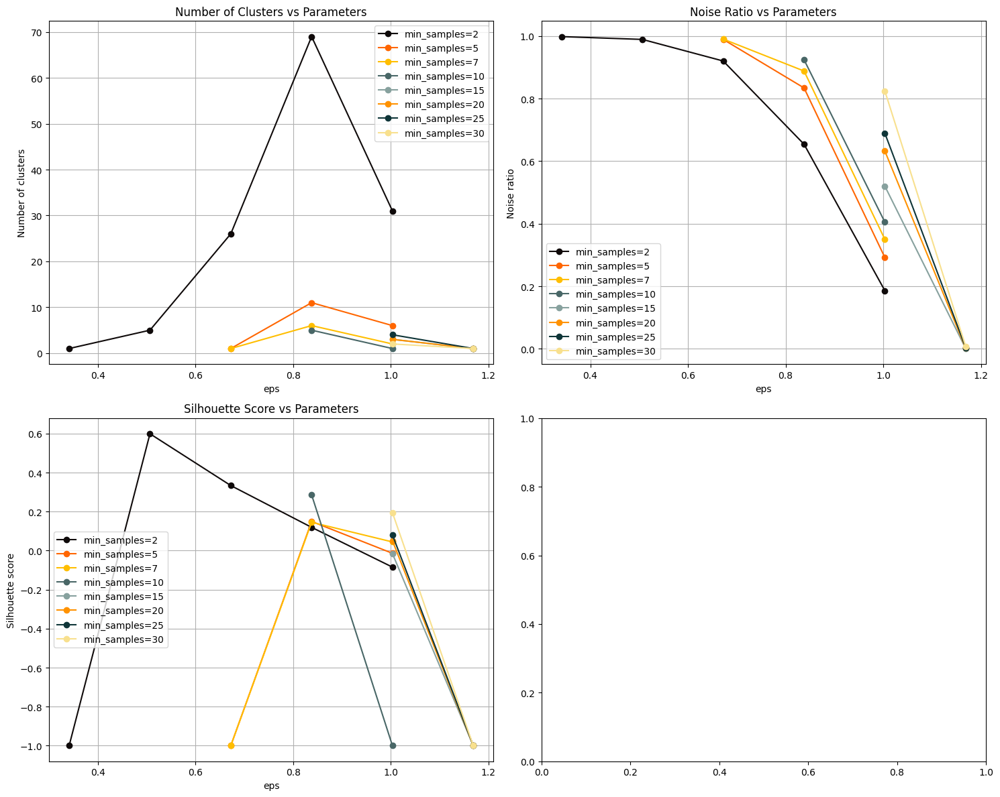


Best parameters based on silhouette score:
eps: 0.507
min_samples: 2
Number of clusters: 5
Noise ratio: 0.989
Silhouette score: 0.599


In [22]:
# Then evaluate parameter combinations around that value
eps_range = np.linspace(0.01, 1.5, 10) # np.linspace(optimal_eps * 0.1, optimal_eps * 7, 20)
min_samples_range = [2, 5, 7, 10, 15, 20, 25, 30]
results, best_params = evaluate_dbscan_params(
    embeddings, 
    eps_range=eps_range,
    min_samples_range=min_samples_range
)

# Use optimal values

In [27]:
# cluster_classifier=ClusterClassifier(
#     embed_model_name=EMBD_MODEL,
#     embed_device="cuda",
#     use_gemini=True,
#     gemini_token=GEMINI_TOKEN,
#     embed_batch_size=512,
#     summary_create=False,
#     method='umap',
#     dbscan_eps=best_params['eps'],
#     dbscan_min_samples=int(best_params['min_samples']),
# )


cluster_classifier=ClusterClassifier(
    embed_model_name=EMBD_MODEL,
    embed_device="cuda",
    use_gemini=True,
    gemini_token=GEMINI_TOKEN,
    embed_batch_size=512,
    summary_create=False,
    method='umap',
    dbscan_eps=optimal_eps,
    dbscan_min_samples=min_samples,
)

INFO:sentence_transformers.SentenceTransformer:Load pretrained SentenceTransformer: BounharAbdelaziz/Morocco-Darija-Sentence-Embedding-v0.2


In [28]:
print("[INFO] Fit Cluster Classifier...")
if 'TerjamaBench' in DATA_PATH:
    embs,labels,summaries = cluster_classifier.fit(ds["Darija"])
elif 'zbliss' in DATA_PATH:
    embs,labels,summaries = cluster_classifier.fit(ds["gherbal_cleaned_text"])
else:
    embs,labels,summaries = cluster_classifier.fit(ds["text"])

INFO:root:embedding texts...


[INFO] Fit Cluster Classifier...


Batches: 100%|██████████| 2/2 [00:29<00:00, 14.62s/it]
INFO:root:building faiss index...
INFO:root:projecting with umap...
/home/infres/abounhar/.local/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

INFO:root:dbscan clustering on projected embeddings...


Using DBSCAN (eps, nim_samples)=((0.4568248391151428,), 2)


In [ ]:
print("[INFO] Save Cluster Classifier...")
cluster_classifier.save("cluster_classifier")

print("[INFO] Show Cluster Classifier Result...")
default_cycler = (cycler(color=[
    "#0F0A0A",  # Dark Grayish Black
    "#FF6600",  # Vivid Orange
    "#FFBE00",  # Bright Yellow
    "#496767",  # Muted Teal
    "#87A19E",  # Soft Cyan-Gray
    "#FF9200",  # Deep Orange
    "#0F3538",  # Dark Cyan-Teal
    "#F8E08E",  # Pastel Yellow
    "#0F2021",  # Very Dark Cyan
    "#FAFAF0",  # Off-White
    "#8B0000",  # Dark Red
    "#4682B4",  # Steel Blue
    "#32CD32",  # Lime Green
    "#9370DB",  # Medium Purple
    "#FFD700",  # Gold
    "#DC143C",  # Crimson Red
    "#00CED1",  # Dark Turquoise
    "#2E8B57",  # Sea Green
    "#FF1493"   # Deep Pink
    ]))
plt.rc('axes', prop_cycle=default_cycler)
cluster_classifier.show(True)

[INFO] Save Cluster Classifier...
[INFO] Show Cluster Classifier Result...
